In [1]:
from HeaderP import *

In [2]:
import astropy.units as u
from astropy.coordinates import SkyCoord
from astroquery.gaia import Gaia
from matplotlib.patches import Rectangle
from matplotlib.collections import PatchCollection


In [3]:
# from So
import requests
def download_ztf_archive_lightcurves(ra, dec, sr=0.001):
    ra = str(ra)
    dec = str(dec)
    url1 = "https://irsa.ipac.caltech.edu/cgi-bin/ZTF/nph_light_curves?POS=CIRCLE "
    url2 = f"{ra} {dec} {sr}&BANDNAME=r&NOBS_MIN=30&BAD_CATFLAGS_MASK=32768&FORMAT=ipac_table"
    url = url1 + url2
    r = requests.get(url)
    f = open(f"./lc/ra_{ra}_dec_{dec}", "wb")
    f.write(r.content)  # save to file
    

In [4]:
data = pd.read_pickle('gaia_obsnumb_absg7.pkl')

In [5]:
data.columns

Index(['source_id', 'ra', 'dec', 'parallax', 'parallax_error', 'gmag', 'bp_rp',
       'pmra', 'pmdec', 'dr2_radial_velocity', 'dr2_radial_velocity_error',
       'ruwe', 'abs_G', 'ZTFobsNumb', 'ZTF_g_lc_Numb', 'ZTF_r_lc_Numb',
       'ZTF_i_lc_Numb'],
      dtype='object')

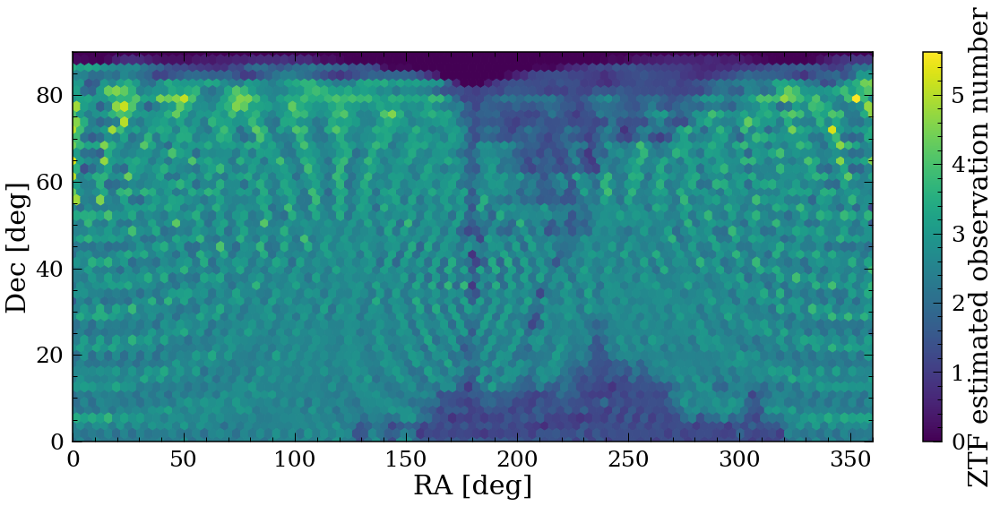

In [6]:
fig, ax = plt.subplots(figsize=(20,8))
plt.hexbin(data['ra'], data['dec'], C = data['ZTF_r_lc_Numb'], extent = (0,360,0,90), gridsize=(100, 25))
plt.xlim([0, 360])
plt.ylim([0, 90])
plt.xlabel('RA [deg]')
plt.ylabel('Dec [deg]')
cb = plt.colorbar()
cb.set_label('ZTF estimated observation number')

462


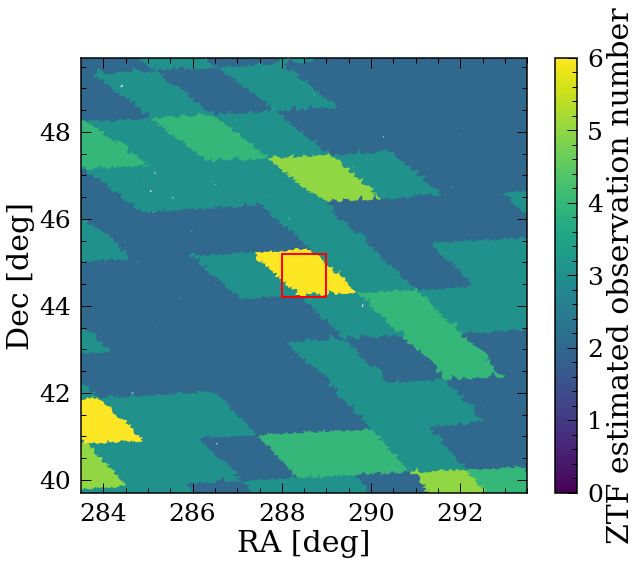

In [7]:
# check a small patch
xcenter, ycenter = 288.5, 44.7
boxsize = 1


fig, ax = plt.subplots(figsize=(10,8))
m_plt =(abs(data['ra']-xcenter)<5*boxsize)&(abs(data['dec']-ycenter)<5*boxsize).values
data_plt = data.loc[m_plt].reset_index(drop=True)
plt.scatter(data_plt['ra'], data_plt['dec'], c = data_plt['ZTF_r_lc_Numb'], vmin = 0, vmax=6)
plt.xlabel('RA [deg]')
plt.ylabel('Dec [deg]')
plt.xlim([xcenter-5*boxsize,xcenter+5*boxsize])
plt.ylim([ycenter-5*boxsize,ycenter+5*boxsize])
cb = plt.colorbar()
cb.set_label('ZTF estimated observation number')
selbox = Rectangle((xcenter - boxsize/2, ycenter - boxsize/2), boxsize, boxsize, edgecolor = 'r',
                  fill=None, linewidth=2)
ax.add_patch(selbox)

m =(abs(data['ra']-xcenter)<boxsize/2)&(abs(data['dec']-ycenter)<boxsize/2).values
data_subset = data.loc[m].reset_index(drop=True)
"""
plt.scatter(data_subset['ra'], data_subset['dec'], c = data_subset['ZTF_r_lc_Numb'], edgecolor='r',
           vmin = 0, vmax=6)
"""
print(len(data_subset))

In [8]:
ras = data_subset['ra'].values
decs = data_subset['dec'].values

In [10]:

for i in trange(len(ras)):
    download_ztf_archive_lightcurves(ras[i], decs[i], sr=0.001)



100%|██████████| 462/462 [1:48:25<00:00, 14.08s/it]  


  4%|▍         | 19/462 [00:00<00:07, 57.19it/s]<ipython-input-46-7a61b4a5b1c9>:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(20,8))
100%|██████████| 462/462 [00:09<00:00, 50.33it/s]


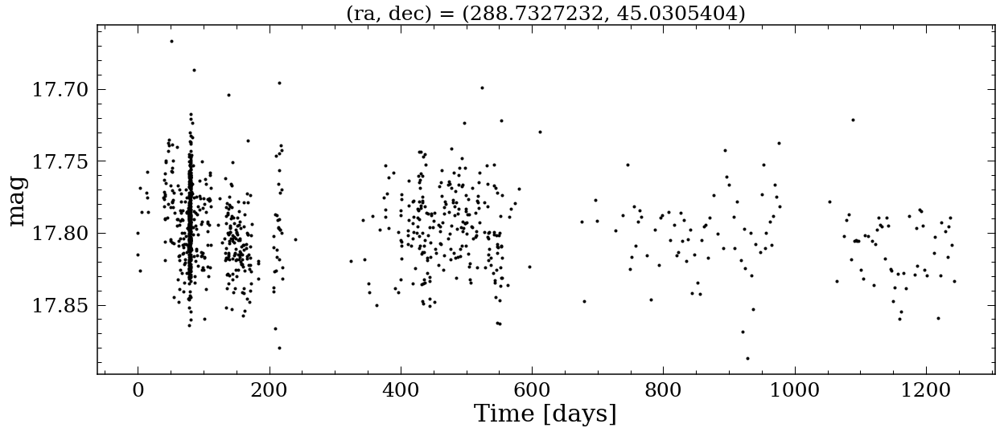

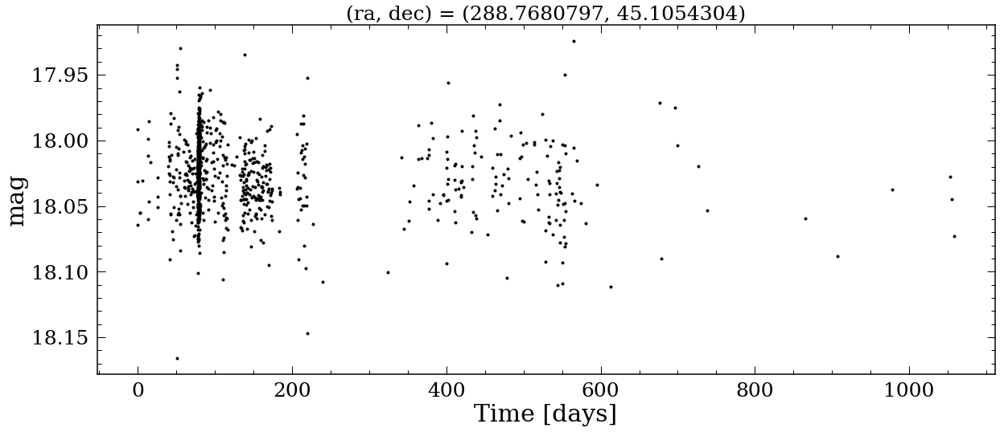

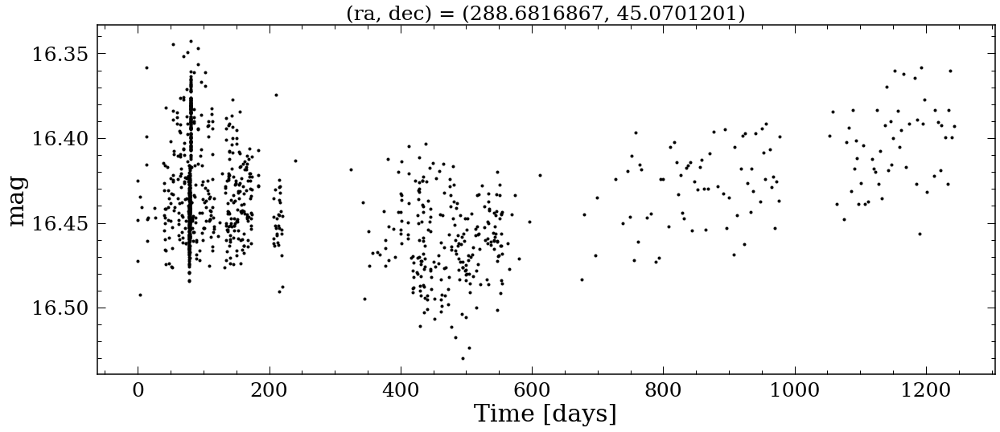

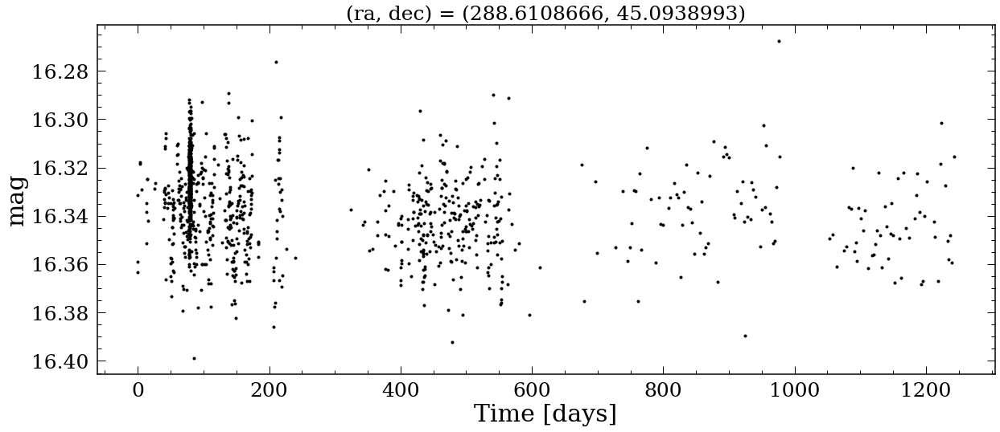

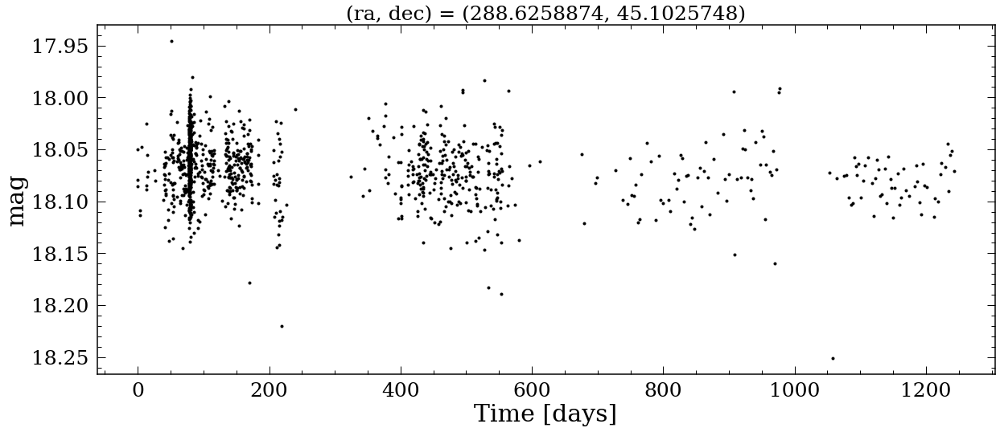

...

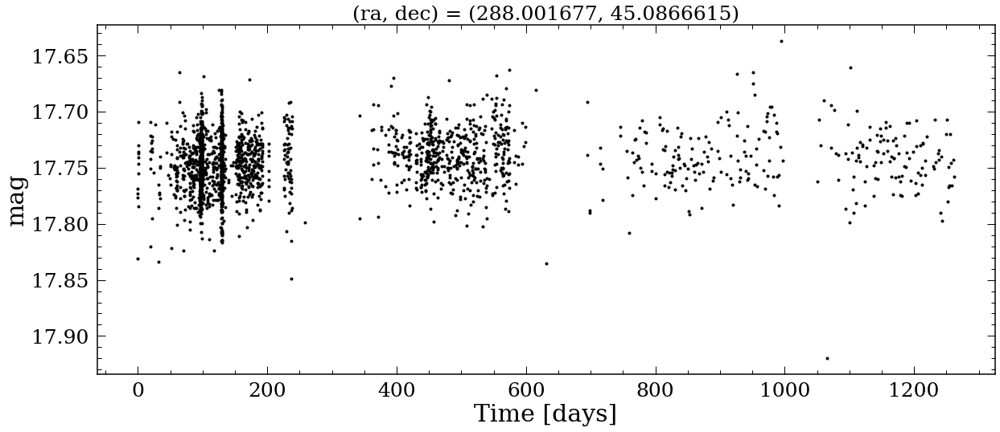

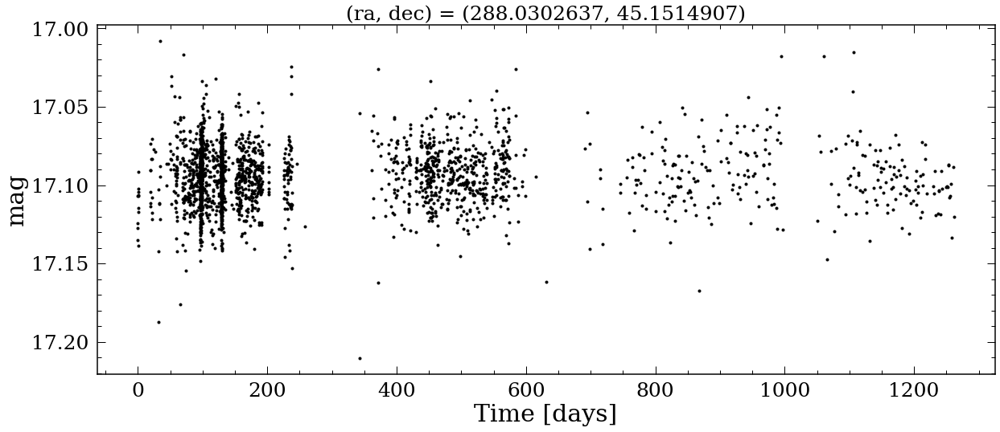

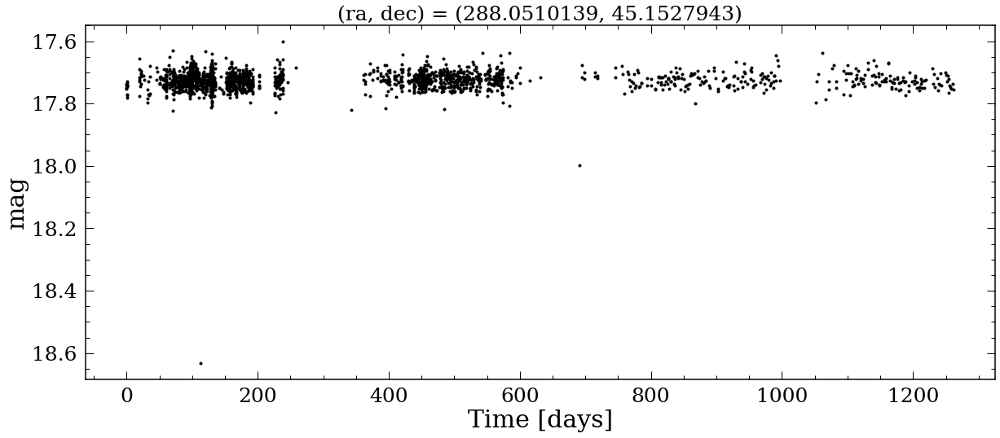

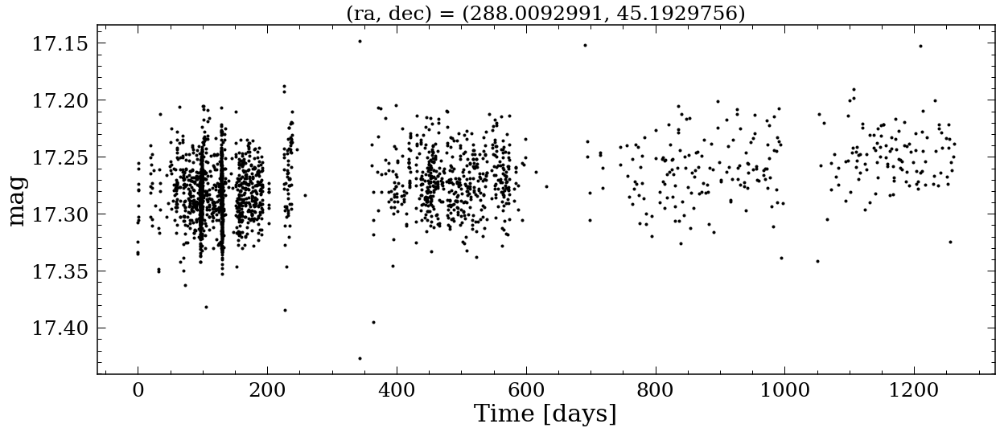

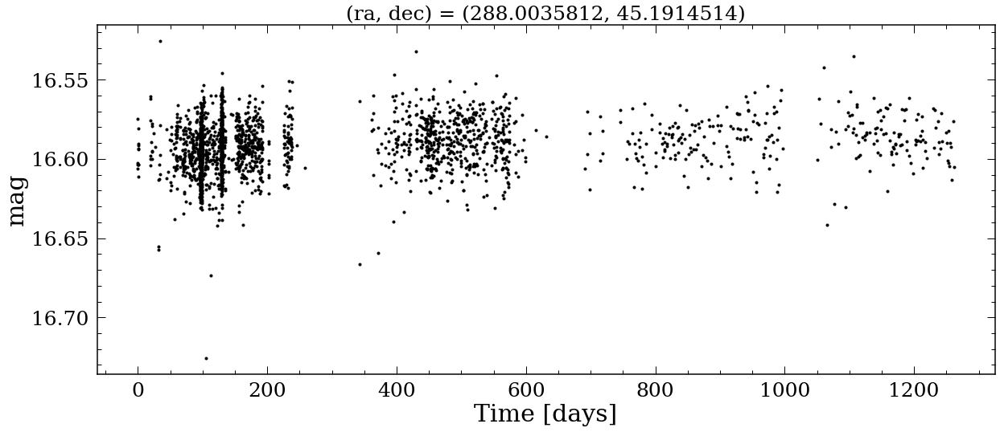

In [46]:
ra_d = np.zeros(len(ras))
dec_d = np.zeros(len(ras))
for i in trange(len(ras)):
    lc_s = pd.read_table('./lc/ra_'+str(ras[i])+'_dec_'+str(decs[i]), delim_whitespace=True, skiprows=54,
             names=['oid','expid','hjd','mjd','mag','magerr','catflags','filtercode',
                     'ra','dec','chi','sharp','filefracday','field','ccdid','qid','limitmag','magzp',
                     'magzprms','clrcoeff','clrcounc','exptime','airmass','programid'])
    
    lc_s = lc_s.loc[lc_s['filtercode']=='zr'].reset_index(drop=True)
    plt.figure(figsize=(20,8))
    plt.plot(lc_s['mjd']-min(lc_s['mjd']),lc_s['mag'],'k.')
    plt.xlabel('Time [days]')
    plt.ylabel('mag')
    plt.gca().invert_yaxis()
    plt.title('(ra, dec) = ('+str(lc_s['ra'].values[0])+', '+str(lc_s['dec'].values[0])+')',fontsize=25)
    
    ra_d[i] = lc_s['ra'].values[0]
    dec_d[i] = lc_s['dec'].values[0]
    